<a href="https://colab.research.google.com/github/Pchristman/Animal-Classification-ML/blob/main/AnimalClassification.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Image Classification Model 

This notebook will house the Machine Learning algorithm I am creating for my WGU Capstone project for Computer Science. The model will use Transfer Learning by importing a model from TensorHub that is trained on the Inception V3 algorithm

In [ ]:
# Import libaries
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import os
import datetime
import math

import tensorflow as tf
import tensorflow_hub as hub

from sklearn.model_selection import train_test_split
from matplotlib.pyplot import imread
from IPython.display import Image
from sklearn.metrics import classification_report, accuracy_score

%load_ext tensorboard




In [ ]:
# If running on Jupyter notebook copy and paste the following line as base_dir
# "/data/"
base_dir = "drive/MyDrive/Capstone/data/"
labels = os.listdir(base_dir)
labels

['sheep',
 'spider',
 'squirrel',
 'butterfly',
 'cat',
 'chicken',
 'cow',
 'dog',
 'elephant',
 'horse']

## Converting data to more usable format.

I want to go through this data and create a dataframe with the image filename and the label it corresponds to.

In [ ]:
# The following cell will be commented out, as the csv is already made
# Just wanted to show how I converted the data into a form that I wanted.
file_set = []
label_set = []

for label in labels:
  path = os.path.join(base_dir, label+"/")
  for image in os.listdir(path):
    file_set.append(image)
    label_set.append(label)

df = pd.DataFrame({"Filename" : file_set, 
                   "Animal" : label_set})

df = df.sample(frac=1)
df.to_csv("drive/MyDrive/Capstone/label.csv", index=False)

### Turning the data into tensors

The data has to be in a numerical format to work with a MachineLearning model, so I'm going to turn the images into tensors.

In [ ]:
# If on Jupyter Notebook path below is "label.csv"
label_csv = pd.read_csv("drive/MyDrive/Capstone/label.csv")
print(label_csv.describe())
print(label_csv.head())

         Filename Animal
count       26179  26179
unique      25840     10
top     1033.jpeg    dog
freq            2   4863
                              Filename     Animal
0  OIP-49zDW_5CB2AHjLpNSOTR9QHaHa.jpeg        dog
1  OIP-BXfDm4rszWP8XUi7CNXiGAHaGr.jpeg  butterfly
2  OIP-N_zc69BT4y1WuvFNGcbqqQHaEu.jpeg   elephant
3  OIP-_6GxeiPFXPS5O4d8C553cwHaE7.jpeg      horse
4  OIP-pq6vL0e3kXSfvNw30_PDSwHaE8.jpeg   squirrel


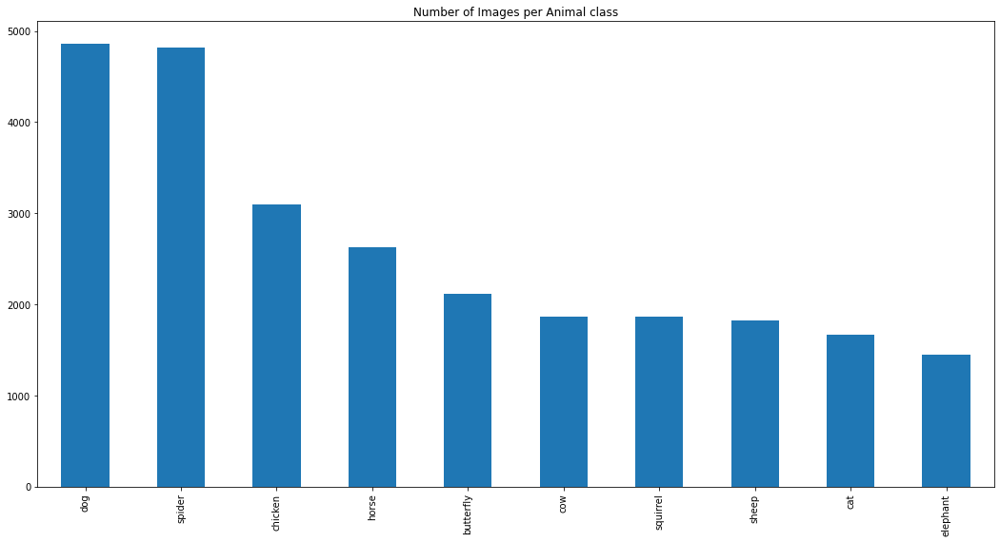

In [ ]:
# How many images are there of each breed?
label_csv.Animal.value_counts().plot.bar(figsize=(18, 9),
                                         title="Number of Images per Animal class");

### The graph above shows contrast

The difference in amount of data for each class could lead the model to perform better when recognizing images from the dog class rather than the elephant class.


### Getting images and labels

We want to make a list of our full image pathname

In [ ]:
# If on JN file path below is "/data/"
filenames = []
for row in label_csv:
  filenames.append("drive/MyDrive/Capstone/data/" + label_csv["Animal"] + "/" + label_csv["Filename"])
filenames = filenames[0]

In [ ]:
filenames.head()

0    drive/MyDrive/Capstone/data/dog/OIP-49zDW_5CB2...
1    drive/MyDrive/Capstone/data/butterfly/OIP-BXfD...
2    drive/MyDrive/Capstone/data/elephant/OIP-N_zc6...
3    drive/MyDrive/Capstone/data/horse/OIP-_6GxeiPF...
4    drive/MyDrive/Capstone/data/squirrel/OIP-pq6vL...
dtype: object

In [ ]:
# Now that we've got the image filepaths in a list, let's prepare the labels
label_np = label_csv["Animal"].to_numpy()
unique_animals = np.unique(label_np)
boolean_labels = [label == unique_animals for label in label_np]
boolean_labels[:5]

[array([False, False, False, False,  True, False, False, False, False,
        False]),
 array([ True, False, False, False, False, False, False, False, False,
        False]),
 array([False, False, False, False, False,  True, False, False, False,
        False]),
 array([False, False, False, False, False, False,  True, False, False,
        False]),
 array([False, False, False, False, False, False, False, False, False,
         True])]

### Creating validation set

Since the images in this dataset aren't split into test or validation, I'm going to do it myself.

In [ ]:
# Set up X & y datasets
X = filenames
y = boolean_labels

I'm going to start off with 2000 images and increase as needed.

In [ ]:
# Set the slider to use to alter number of images for experimentation (Only available in Google Colab)
NUM_IMG = 2000 #@param {type: "slider", min:2000, max:10000, step:1000}

In [ ]:
# Split the data into training and validation sets of size NUM_IMG
X_train, X_val, y_train, y_val = train_test_split(X[:NUM_IMG],
                                                  y[:NUM_IMG],
                                                  test_size=0.2,
                                                  random_state=77)

len(X_train), len(X_val), len(y_train), len(y_val)

(1600, 400, 1600, 400)

In [ ]:
X_train[:5], y_train[:5]

(617     drive/MyDrive/Capstone/data/squirrel/OIP-s7iWZ...
 1437    drive/MyDrive/Capstone/data/sheep/eb36b70620f1...
 253     drive/MyDrive/Capstone/data/horse/OIP-Ee8fxcBD...
 1912    drive/MyDrive/Capstone/data/cat/ea36b10e29fc07...
 141     drive/MyDrive/Capstone/data/squirrel/OIP-fij6A...
 dtype: object,
 [array([False, False, False, False, False, False, False, False, False,
          True]),
  array([False, False, False, False, False, False, False,  True, False,
         False]),
  array([False, False, False, False, False, False,  True, False, False,
         False]),
  array([False,  True, False, False, False, False, False, False, False,
         False]),
  array([False, False, False, False, False, False, False, False, False,
          True])])

## Preprocessing Images (Turning them into Tensors)

I'm going to create a function to preprocess an image and turn it into a Tensor with the correct size of (224, 224)

In [ ]:
# Define a constant image size
IMAGE_SIZE = 224

# Created the function for preprocessing images
def preprocess_image(img_fpath):
  """
  This functions takes an image path and turns the image into a Tensor
  """
  image = tf.io.read_file(img_fpath)
  image = tf.image.decode_jpeg(image, channels=3)
  image = tf.image.convert_image_dtype(image, tf.float32)
  image = tf.image.resize(image, size=[IMAGE_SIZE, IMAGE_SIZE])

  return image

## Now it's time to batch the data

We're going to use the standard batch size of 32, and we're going to turn the data into Tensor tuples

In [ ]:
# Created a function to return a tuple

def get_image_animal(img_fpath, animal):
  """
  Takes the image filepath and the associated animal name, processes the image
  and returns a tuple of the form (image, animal)
  """
  img = preprocess_image(img_fpath)
  return img, animal

In [ ]:
# Created a function to turn all the data in batches
BATCH_SIZE = 32

def create_batches(X, y=None, batch_size=BATCH_SIZE, valid=False, test=False):
  """
  This creates batches out of the X,y tuple pairs.
  It will shuffle the data if its training data, but not if its validation
  data. It also accepts test data, which have no labels.
  """
  if test:
    print("Creating test batches")
    data = tf.data.Dataset.from_tensor_slices(tf.constant(X))
    d_batch = data.map(preprocess_image).batch(BATCH_SIZE)
    return d_batch

  elif valid:
    print("Creating validation batches")
    data = tf.data.Dataset.from_tensor_slices((tf.constant(X), 
                                              tf.constant(y)))
    d_batch = data.map(get_image_animal).batch(BATCH_SIZE)
    return d_batch

  else:
    print("Creating training batches")
    data = tf.data.Dataset.from_tensor_slices((tf.constant(X), 
                                               tf.constant(y)))
    data = data.shuffle(buffer_size=len(X))
    d_batch = data.map(get_image_animal).batch(BATCH_SIZE)
    return d_batch

In [ ]:
# Now we can create our training and validation data batches
train_batch = create_batches(X_train, y_train)
val_batch = create_batches(X_val, y_val, valid=True)

Creating training batches
Creating validation batches


## Visual of Batches

In [ ]:
# Created a function for viewing images in a batch
def show_25_animals(images, animals):
  """
  Displays a 6x5 plot of animal images and the corresponding label from a batch
  """
  plt.figure(figsize=(15,15))
  for i in range(25):
    ax = plt.subplot(5,5,i+1)
    plt.imshow(images[i])
    plt.title(unique_animals[animals[i].argmax()])
    plt.axis("off")



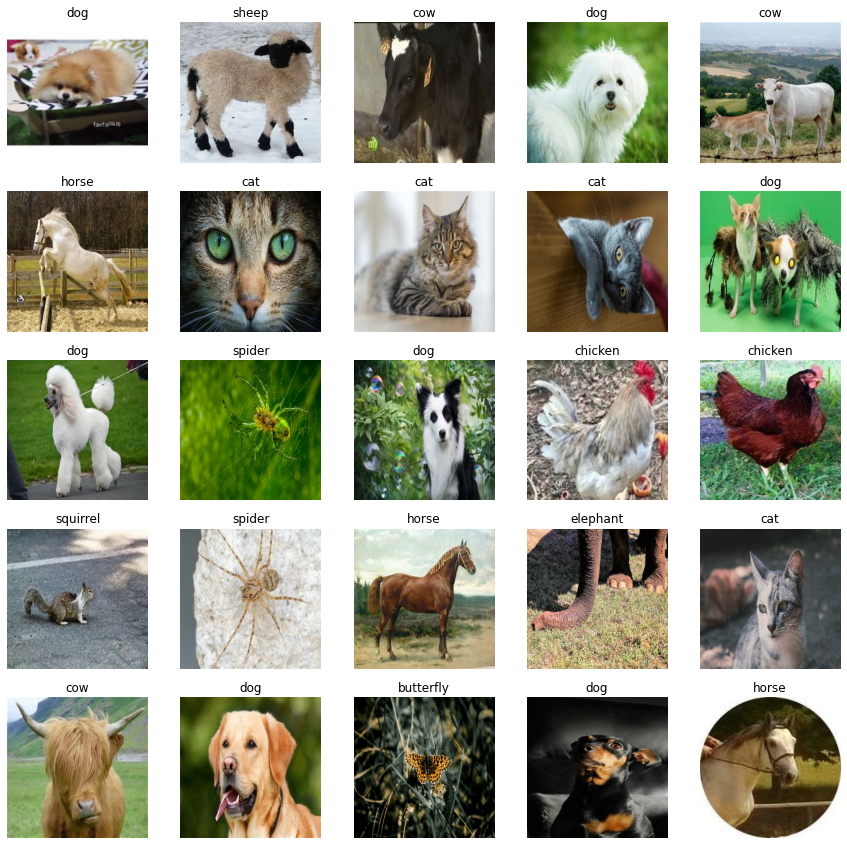

In [ ]:
# You can re-run this cell to see different animal images appear
train_images, train_animals = next(train_batch.as_numpy_iterator())
show_25_animals(train_images, train_animals)

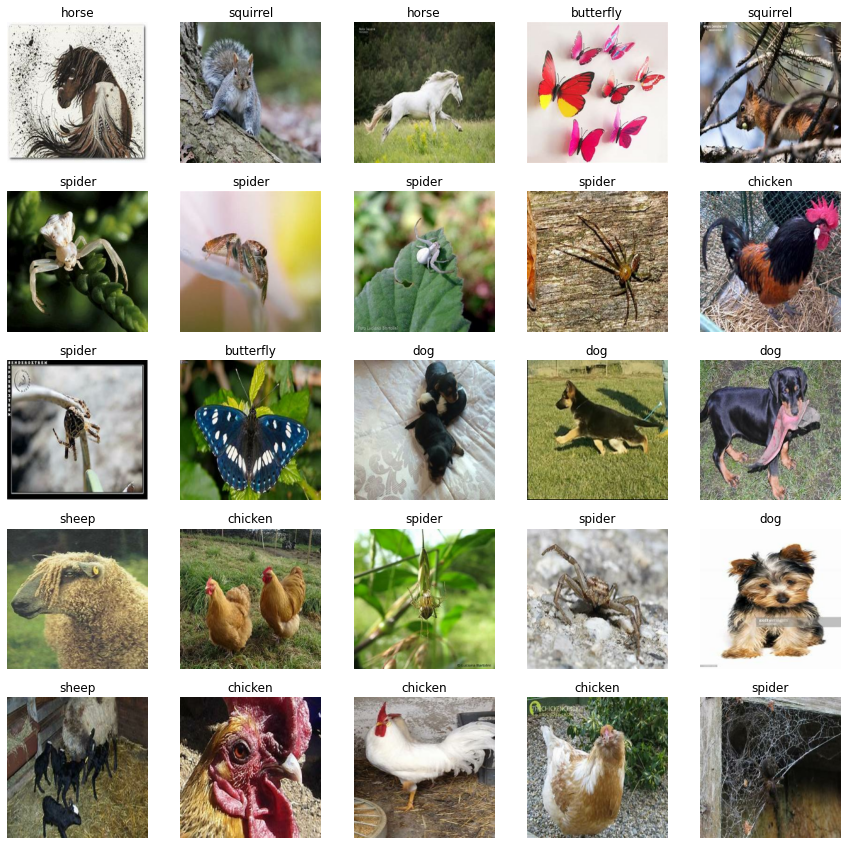

In [ ]:
# This cell will remain the same each time its ran
val_images, val_labels = next(val_batch.as_numpy_iterator())
show_25_animals(val_images, val_labels) 

## Building the model

There's a few things that need to be defined prior to building the model.
* The input shape of the images into the model
* The output shape of the image labels of the model.
* The URL of the model thats being used from TensorFlow Hub

In [ ]:
INPUT_SHAPE = [None, IMAGE_SIZE, IMAGE_SIZE, 3] # (Batch, Height, Width, Color Channels)
OUTPUT_SHAPE = len(unique_animals)
MODEL_URL = "https://tfhub.dev/google/imagenet/inception_v3/classification/5"

In [ ]:
# Created a function which builds a deep-learning Keras model
def create_model(input_shape=INPUT_SHAPE, output_shape=OUTPUT_SHAPE, model_url=MODEL_URL):
  print("Building model with the model found at: ", model_url)

  model = tf.keras.Sequential([
                               hub.KerasLayer(model_url), 
                               tf.keras.layers.Dense(units=output_shape,
                                                     activation="softmax")
  ])

  model.compile(
      loss=tf.keras.losses.CategoricalCrossentropy(),
      optimizer=tf.keras.optimizers.Adam(),
      metrics=["accuracy"]
  )

  model.build(input_shape)

  return model

In [ ]:
model = create_model()

Building model with the model found at:  https://tfhub.dev/google/imagenet/inception_v3/classification/5


In [ ]:
model.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
keras_layer (KerasLayer)     (None, 1001)              23853833  
_________________________________________________________________
dense (Dense)                (None, 10)                10020     
Total params: 23,863,853
Trainable params: 10,020
Non-trainable params: 23,853,833
_________________________________________________________________


## Creating callbacks

Two callbacks will be created:
1. A callback for TensorBoard that will track the models progress
2.  callback for early stopping to (attempt) prevent from overfitting

In [ ]:
# A function to create the TensorBoard callback
# If on JN file path belows is "/logs/"
def create_tensorbord_cb():
  logdir = os.path.join("drive/MyDrive/Capstone/logs/",
                        datetime.datetime.now().strftime("%Y-%m-%d_%H%M%S"))
  return tf.keras.callbacks.TensorBoard(logdir)

In [ ]:
# A function to created the early stopping callback
early_stop = tf.keras.callbacks.EarlyStopping(monitor="val_accuracy",
                                              patience=3)

## Train model on a subset of data

### Saving and loading a model

Here I'm going to create functions that will be used to save a reload a trained 
model just in case a disconnect occurs

In [ ]:
# Function to save a model
# If on JN file path below is "/models"
def save_mod(model, suffix=None):
  """
  Saves a model and appends a string suffix to the end
  """
  moddir = os.path.join("drive/MyDrive/Capstone/models",
                        datetime.datetime.now().strftime("%Y-%m-%d_%H%M%S"))
  model_fpath = moddir + "-" + suffix + ".h5"
  print(f"Saving model to: {model_fpath}")
  model.save(model_fpath)
  return model_fpath

In [ ]:
# Function to load a trained model
def load_mod(model_fpath):
  """
  Loads a model from a specified file path
  """
  print(f"Loading model from path: {model_fpath}")
  model = tf.keras.models.load_model(model_fpath,
                                     custom_objects={"KerasLayer":hub.KerasLayer})
  return model

In [ ]:
NUM_EPOCHS = 100

In [ ]:
# Created a function that trains and then returns the trained model
def train_model():
  """
  Trains a model and returns the trained model
  """
  model = create_model()
  tb = create_tensorbord_cb()

  model.fit(x=train_batch,
            epochs=NUM_EPOCHS,
            validation_data=val_batch,
            validation_freq=1,
            callbacks=[tb, early_stop])
  
  return model

In [ ]:
# This cell make take a while to run
# Next two cells are commented out to save runtime
# model = train_model()

In [ ]:
# save_mod(model, suffix="first_model")

In [ ]:
# If on JN file path below is "/models/2021-08-14_171048-first_model.h5"
model = load_mod('drive/MyDrive/Capstone/models/2021-08-14_171048-first_model.h5')

Loading model from path: drive/MyDrive/Capstone/models/2021-08-14_171048-first_model.h5


In [ ]:
# Checking the logs directory through TensorBoard and visualizing it
%tensorboard --logdir drive/MyDrive/Capstone/logs/

<IPython.core.display.Javascript object>

### TensorBoard Impressions

From first impressions on appearance of this graph, it looks like our model is overfitting. On the first epoch, it looked like the data was underfitting, due to the validation accuracy being much higher than the training data, but on the second epoch the relationship between the values flipped. All in all though, the model appears to be learning from the data so we will test the predictions on the mode.

We will the assess the TensorBoard again after training the model again on the full set of data

## Making and Evaluating Predictions

In [ ]:
# Make predictions on the validation data
# This cell may take a couple of minutes to run
animal_preds = model.predict(val_batch, verbose=1)
animal_preds

13/13 [==============================] - 41s 2s/step


array([[4.1594557e-04, 1.3842332e-04, 5.1919546e-04, ..., 2.2860488e-03,
        4.3180259e-04, 3.7959183e-04],
       [5.8500351e-08, 1.4340777e-06, 4.1243439e-08, ..., 2.2342522e-07,
        1.2273050e-07, 9.9999702e-01],
       [3.8184712e-06, 2.9615534e-04, 1.5179785e-05, ..., 3.0332540e-06,
        3.1250707e-05, 1.0112451e-08],
       ...,
       [1.1363743e-05, 5.0500512e-06, 1.4943571e-05, ..., 9.6004612e-07,
        9.9941230e-01, 8.6084071e-07],
       [2.2005312e-07, 4.0753417e-07, 3.0493150e-06, ..., 6.2604819e-08,
        9.9994886e-01, 2.0167730e-07],
       [8.2858263e-05, 2.2695718e-05, 4.4493473e-07, ..., 3.2267428e-05,
        4.6083278e-05, 1.5335111e-08]], dtype=float32)

In [ ]:
# Expand the prediction by index. 
# Change the index value here and rerun cell to
# see different prediction values
pred_index = 0
print(animal_preds[pred_index])
print(f"Max value (probability of prediction): {np.max(animal_preds[pred_index])}")
print(f"Predicted label: {unique_animals[np.argmax(animal_preds[pred_index])]}")

[4.1594557e-04 1.3842332e-04 5.1919546e-04 2.8058096e-06 1.2771640e-02
 1.6395967e-03 9.8141497e-01 2.2860488e-03 4.3180259e-04 3.7959183e-04]
Max value (probability of prediction): 0.9814149737358093
Predicted label: horse


In [ ]:
# Created function to turn a prediction probability into its label name (animal)
def get_pred_animal(animal_preds):
  """
  Turns an array of probability values into the corresponding value from the 
  unique animal classes
  """
  return unique_animals[np.argmax(animal_preds)]

In [ ]:
# Created a function to unbatch data, due to our validation data being in a batch
# and we don't want the model to know the label value when comparing the predictions
def unbatch(batch):
  """
  Takes a batched dataset of tuples (image, animal) Tensors and returns them to an array of images and animal names
  """
  images = []
  animals = []

  for image, animal in batch.unbatch().as_numpy_iterator():
    images.append(image)
    animals.append(get_pred_animal(animal))

  return images, animals

In [ ]:
# Now unbatch the validation data
val_image, val_animal = unbatch(val_batch)

In [ ]:
# The following function will plot the predicted animal, the true label and the target image on a single plot
def plot_animal_pred(animal_preds, animals, images, n=67):
  """
  Views the prediction, the true label and the image for sample index n
  """
  anim_prob, true_anim, image = animal_preds[n], animals[n], images[n]
  # Get the predicted animal name
  anim_pred_label = get_pred_animal(anim_prob)
  # Plots the image and removes the ticks on the axis
  plt.imshow(image)
  plt.xticks([])
  plt.yticks([])
  # Change the color of the text to signify if the prediction was right or wrong
  if anim_pred_label == true_anim:
    color = "green"
  else:
    color = "red"
  # Change the plot title
  plt.title("{}: {:2.0f}%. ({})".format(anim_pred_label,
                                        np.max(anim_prob)*100,
                                        true_anim),
                                        color=color)


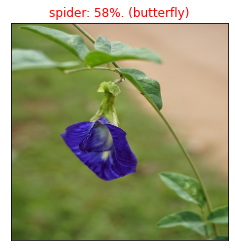

In [ ]:
plot_animal_pred(animal_preds,val_animal, val_image, n=302)

## Plot Notes

Now when testing this function I saw that it would determine an image contained an animal with only 65% confidence but still got it correct. I want to create a function that displays the top 5 prediction values.

In [ ]:
# The following function will display the top 5 prediction values with it
def plot_animal_pred_5(animal_preds, animals, n=67):
  """
  Plots the top 5 prediction alues along with the true animal label for sample index n
  """
  anim_prob, true_anim = animal_preds[n], animals[n]

  # Find the top 5 prediction value's indexes
  top_5_idx = anim_prob.argsort()[-5:][::-1]
  # Find the top 5 prediction value
  top_5_value = anim_prob[top_5_idx]
  # Find the top 5 animal names
  top_5_anim = unique_animals[top_5_idx]
  # Create plot
  top_5_plot = plt.bar(np.arange(len(top_5_anim)),
                       top_5_value,
                       color="gray")
  plt.xticks(np.arange(len(top_5_anim)),
             labels=top_5_anim,
             rotation="vertical")
  # Turn the true animal label green
  if np.isin(true_anim, top_5_anim):
    top_5_plot[np.argmax(top_5_anim == true_anim)].set_color("green")
  else:
    pass

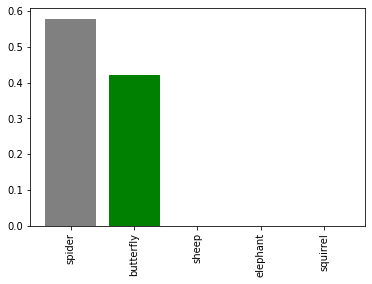

In [ ]:
plot_animal_pred_5(animal_preds, val_animal, n=302)

## Combining the two graphs

I'd love to see how these two functions can not only be combined, to display an image with the predicted animal and probability along with the true animal label, with a bar graph next to it displaying the other probability values.

However, I'd like to be able to scale this up to show more images if I felt the need.

In [ ]:
# Create a function to combine the prior two functions and have the ability to show more
def plot_animal_pred_grid(animal_preds, animals, image, n=67, i_multiplier=1, nrows=1, ncols=1):
  nimgs = nrows * ncols
  plt.figure(figsize=(10*ncols, 5*nrows))
  for i in range(nimgs):
    plt.subplot(nrows, 2 * ncols, 2*i+1)
    plot_animal_pred(animal_preds,
                     animals,
                     image,
                     n=i*i_multiplier)
    plt.subplot(nrows, 2*ncols,2*i+2)
    plot_animal_pred_5(animal_preds,
                       animals,
                       n=i*i_multiplier)
  plt.tight_layout(h_pad=1.0)
  plt.show()

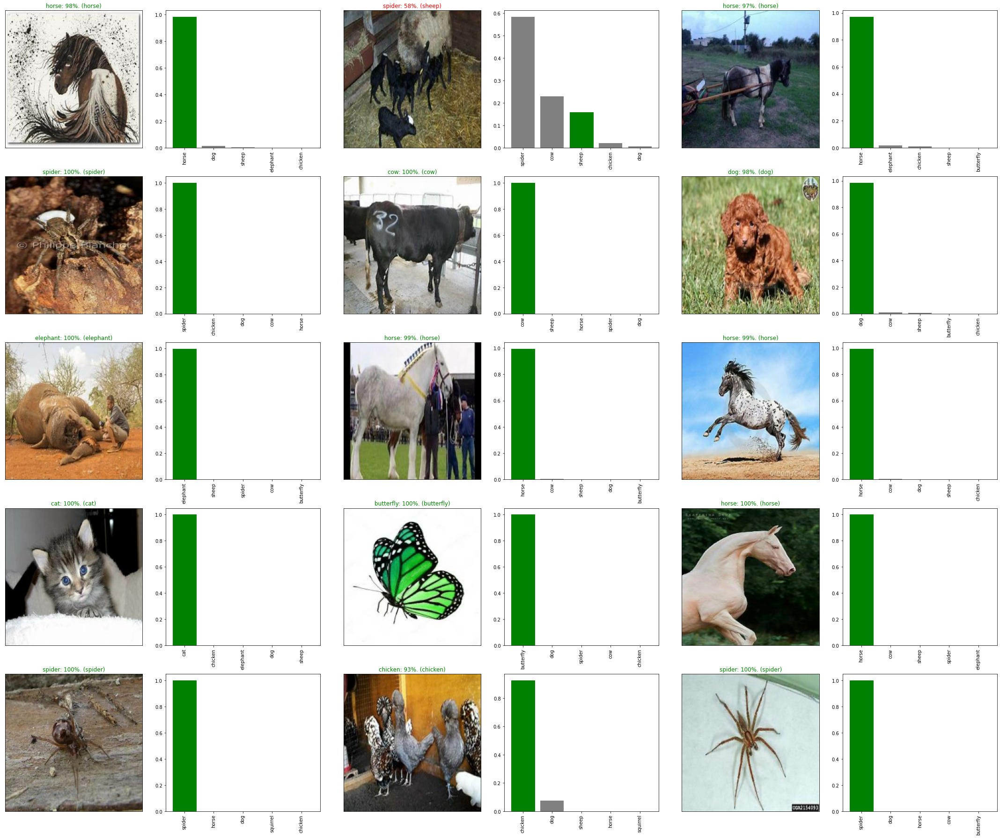

In [ ]:
plot_animal_pred_grid(animal_preds, val_animal, val_image, 67, 20, 5, 3)

In [ ]:
model.evaluate(val_batch)

13/13 [==============================] - 3s 128ms/step - loss: 0.2329 - accuracy: 0.9400


[0.23294256627559662, 0.9399999976158142]

## Training the model on the full set of data

Time to train the model on all of the data and see if the data bias goes away.

In [ ]:
full_data = create_batches(X, y)

Creating training batches


In [ ]:
# Create a model for the full dataset
full_model = create_model()

Building model with the model found at:  https://tfhub.dev/google/imagenet/inception_v3/classification/5


In [ ]:
# Create callbacks for the fullmodel
full_model_tb = create_tensorbord_cb()

# Since theres no validation data on the full set, we have to set early stopping
# on regular accuracy
full_early_stop = tf.keras.callbacks.EarlyStopping(monitor="accuracy",
                                                         patience=3)

In [ ]:
NUM_EPOCHS = 100 #@param {type: "slider", min:5, max:100, step:5}

**THE CELL BELOW WILL TAKE A VERY LONG TIME TO RUN**

In [ ]:
# Fits the model to the full set of data
# The next two cells will be commented out to conserve runtime
# full_model.fit(x=full_data,
#                epochs=NUM_EPOCHS,
#                callbacks=[full_model_tb, full_early_stop])

In [ ]:
# save_mod(full_model, suffix="full_dataset_model_inceptionv3")

In [ ]:
# If on JN file path below is "/models/2021-08-14_211938-full_dataset_model_inceptionv3.h5""
full_model = load_mod("drive/MyDrive/Capstone/models/2021-08-14_211938-full_dataset_model_inceptionv3.h5")

Loading model from path: drive/MyDrive/Capstone/models/2021-08-14_211938-full_dataset_model_inceptionv3.h5


In [ ]:
# Checking the logs directory through TensorBoard and visualizing it
%tensorboard --logdir drive/MyDrive/Capstone/logs/

Reusing TensorBoard on port 6006 (pid 279), started 0:00:59 ago. (Use '!kill 279' to kill it.)

<IPython.core.display.Javascript object>

In [ ]:
# This cell will take a long time to run
# This cell be commented on as to save on overhead
# full_model.evaluate(full_data)

819/819 [==============================] - 2915s 4s/step - loss: 0.0362 - accuracy: 0.9888


[0.036243125796318054, 0.9888460040092468]

## Making predictions on Custom Images

I've set up 15 custom images that were either pulled from Google Images or were removed from the dataset at the beginning. The goal here is to see if the model can accurately guess an animal from an image. We, as humans, will be able to tell what the animal is so that will be the method of validation

In the next three cells, I've defined functions that will help visualize the prediction data

In [ ]:
# The following function will plot the test animals and the target image
def plot_test_pred(test_preds, images, n=0):
  """
  Views the prediction animal and the image for sample index n
  """
  anim_prob, image = test_preds[n], images[n]
  # Get the predicted animal name
  anim_pred_label = get_pred_animal(anim_prob)
  # Plots the image and removes the tick on the axis
  plt.imshow(image)
  plt.xticks([])
  plt.yticks([])
  # Change the plot title
  plt.title("{}: {:2.0f}%".format(anim_pred_label,
                                  np.max(anim_prob)*100))

In [ ]:
# The following function will plot the top 5 probability values for the test image
def plot_test_pred_5(test_preds, n=0):
  """
  Plots the top 5 prediction values for sample index n
  """
  anim_prob = test_preds[n]

  # Find the top 5 prediction value's indexes
  top_5_idx = anim_prob.argsort()[-5:][::-1]
  # Find the top 5 prediction value
  top_5_value = anim_prob[top_5_idx]
  # Find the top 5 animal names
  top_5_anim = unique_animals[top_5_idx]
  # Create plot
  top_5_plot = plt.bar(np.arange(len(top_5_anim)),
                       top_5_value,
                       color="gray")
  plt.xticks(np.arange(len(top_5_anim)),
             labels=top_5_anim,
             rotation="vertical")

In [ ]:
# Create a function to combine the prior two functions
# Note: Make sure nrows * ncols equals the amount of test images
def plot_test_pred_grid(test_preds, image, n=0):
  ncols = 3
  nrows = math.ceil(len(image)/3)
  nimgs = len(image)
  plt.figure(figsize=(10*ncols, 5*nrows))
  for i in range(nimgs):
    plt.subplot(nrows, 2 * ncols, 2*i+1)
    plot_test_pred(test_preds,
                   image,
                   n=i)
    plt.subplot(nrows, 2*ncols, 2*i+2)
    plot_test_pred_5(test_preds,
                     n=i)
  plt.tight_layout(h_pad=1.0)
  plt.show()

### Testing test images

In the cell below I have supplied the path to a directory filled with custom images. This path can be subsituted for any path of your choice to a folder filled with images you wish to compare, or my supplied file emptied and replaced with images of your choosing.

In [ ]:
# The line below is the line that you can swap with your own custom file path.
# If on JN file path below is "/test-photos/"
test_path = ""
test_image_path = [test_path + fname for fname in os.listdir(test_path)]

In [ ]:
# Turn the custom images into batches
test_data = create_batches(test_image_path, test=True)

Creating test batches


In [ ]:
# Make predictions on the test data
test_preds = full_model.predict(test_data)

In [ ]:
# Get the predicted animals for the test images
test_pred_anims = [get_pred_animal(test_preds[i]) for i in range(len(test_preds))]

In [ ]:
 # Get test images
 test_images = []
 for image in test_data.unbatch().as_numpy_iterator():
   test_images.append(image)

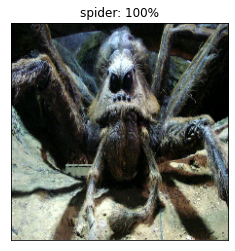

In [ ]:
plot_test_pred(test_preds, test_images, n=9)

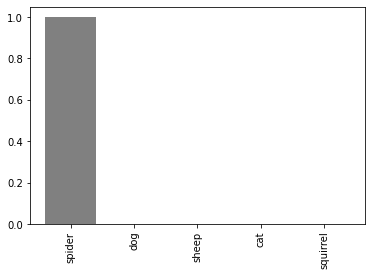

In [ ]:
plot_test_pred_5(test_preds, n=9)

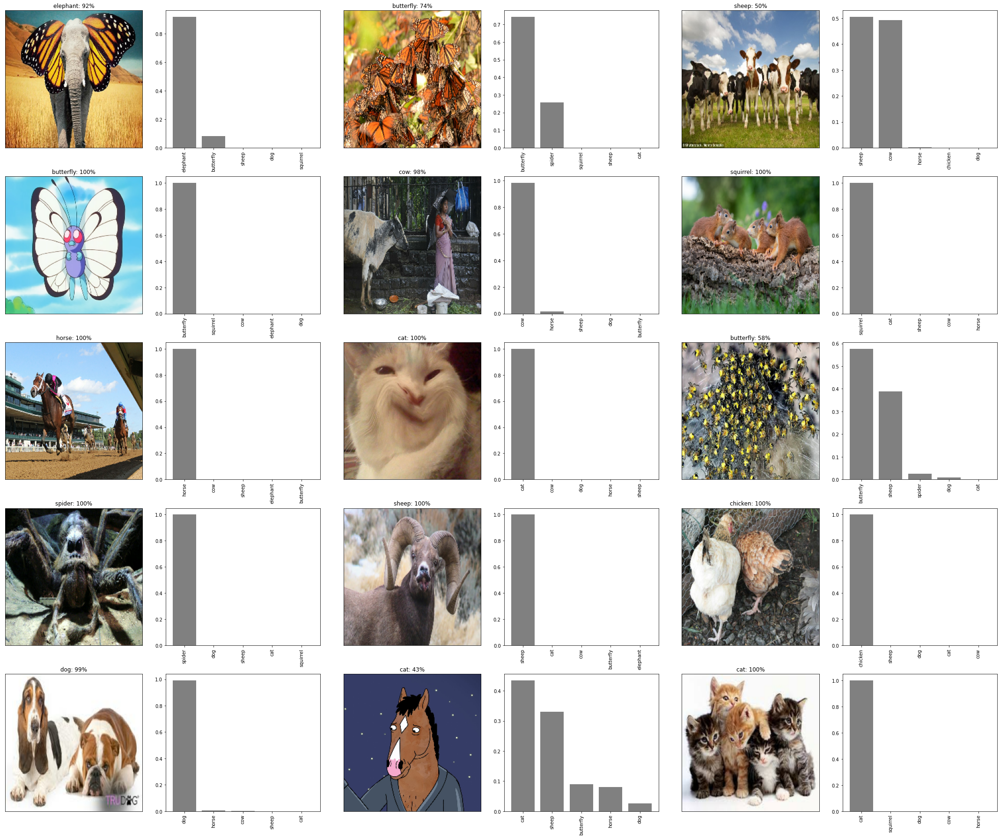

In [ ]:
plot_test_pred_grid(test_preds, test_images,n=0)